In [ ]:
import config
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sqlalchemy import create_engine
import logging
import warnings
warnings.filterwarnings('ignore')
import time
import folium
from folium.plugins import MarkerCluster

In [7]:

def setup_logging():
    """Configures logging to a file, overwriting it on each run."""
    logging.basicConfig(
        filename=config.LOG_FILE,
        level=logging.INFO,
        format='%(asctime)s - %(levelname)s - %(message)s',
        filemode='w',
        force=True
    )

def create_db_engine():
    """Creates a database engine from config settings."""
    try:
        connection_url = (
            f'postgresql+psycopg2://{config.DB_USER}:{config.DB_PASSWORD}@'
            f'{config.DB_HOST}:{config.DB_PORT}/{config.DB_NAME}'
        )
        engine = create_engine(connection_url)
        engine.connect()
        logging.info("Successfully connected to PostgreSQL database.")
        return engine
    except Exception as e:
        logging.error(f"PostgreSQL connection failed: {e}")
        return None

def load_to_postgres(df, table_name, engine):
    """Loads a DataFrame into a specified PostgreSQL table."""
    try:
        df.to_sql(table_name, engine, if_exists='replace', index=False)
        logging.info(f"Successfully loaded data into table '{table_name}'.")
    except Exception as e:
        logging.error(f"Failed to save data to table '{table_name}': {e}")
        raise

In [8]:
def main():
    """Main ETL process function."""
    start_time = time.time()
    setup_logging()
    logging.info("--- Starting SEQ Bus Data ETL Process ---")

    engine = create_db_engine()
    if not engine:
        logging.critical("Could not establish database connection. Aborting.")
        return 

    base_dir = config.GTFS_DATA_PATH

    files_to_process = {
        'calendar_dates.txt': 'calendar_dates',
        'calendar.txt': 'calendar',
        'routes.txt': 'routes',
        'shapes.txt': 'shapes',
        'stop_times.txt': 'stop_times',
        'stops.txt': 'stops',
        'trips.txt': 'trips'
    }
    
    for file_name, table_name in files_to_process.items():
        try:
            file_path = f"{base_dir}/{file_name}"
            
            logging.info(f"Reading {file_name} from directory...")
            df = pd.read_csv(file_path, low_memory=False)
            load_to_postgres(df, table_name, engine)
            
        except FileNotFoundError:
            logging.error(f"File not found: {file_path}. Skipping.")
        except MemoryError:
            logging.error(f"OUT OF MEMORY while loading {file_name}. Aborting process.")
            break 
        except Exception as e:
            logging.error(f"An ETL error occurred for {file_name}. Skipping. Details: {e}")

    end_time = time.time()
    total_seconds = end_time - start_time
    minutes, seconds = divmod(total_seconds, 60)

    final_message = (
        f"--- ETL Process Finished in {int(minutes)} minutes and {seconds:.2f} seconds. ---"
        )
    logging.info(final_message)
    print(final_message)

if __name__ == "__main__":
    main()

--- ETL Process Finished in 2 minutes and 34.88 seconds. ---


In [9]:
engine = create_db_engine()

calendar_dates = pd.read_sql_table('calendar_dates', engine)
calendar = pd.read_sql_table('calendar', engine)
routes= pd.read_sql_table('routes', engine)
shapes = pd.read_sql_table('shapes', engine)
stop_times = pd.read_sql_table('stop_times', engine)
stops = pd.read_sql_table('stops', engine)
trips = pd.read_sql_table('trips', engine)


In [10]:
dfs = {
    'calendar_dates': calendar_dates,
    'calendar': calendar,
    'routes': routes,
    'shapes': shapes,
    'stop_times': stop_times,
    'stops': stops,
    'trips': trips
}


In [11]:
for name, df in dfs.items():
    print(f'\n{name} : TOTAL {df.shape[0]} ROWS\nTOTAL {df.shape[1]} COLUMNS')
    print('==' * 20)
    df.info()


calendar_dates : TOTAL 144 ROWS
TOTAL 3 COLUMNS
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 144 entries, 0 to 143
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   service_id      144 non-null    object
 1   date            144 non-null    int64 
 2   exception_type  144 non-null    int64 
dtypes: int64(2), object(1)
memory usage: 3.5+ KB

calendar : TOTAL 154 ROWS
TOTAL 10 COLUMNS
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 154 entries, 0 to 153
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   service_id  154 non-null    object
 1   monday      154 non-null    int64 
 2   tuesday     154 non-null    int64 
 3   wednesday   154 non-null    int64 
 4   thursday    154 non-null    int64 
 5   friday      154 non-null    int64 
 6   saturday    154 non-null    int64 
 7   sunday      154 non-null    int64 
 8   start_date  154 non-nul

In [12]:
for name, df in dfs.items():
    name_duplicated = df.duplicated().sum()
    print(f'{name}: {name_duplicated}')     

calendar_dates: 0
calendar: 0
routes: 0
shapes: 0
stop_times: 0
stops: 0
trips: 0


<h2><strong><center>DATA CLEANING</h2></strong></center>

In [13]:
#Replacing Irrelevent Values
logging.info("Cleaning 'routes' table")
routes['route_desc'].fillna('No Description', inplace=True)

logging.info("Cleaning 'routes' table")
stops['stop_code'].fillna('0', inplace=True)
stops['stop_desc'].fillna('No Description', inplace=True)
stops['zone_id'].fillna(0, inplace=True)
stops['stop_url'].fillna('Not Available', inplace=True)
stops['platform_code'].fillna('N/A', inplace=True)

#Data Type Conversion for calendar Table
logging.info("Convert  'calendar' date column")
calendar['start_date'] = pd.to_datetime(calendar['start_date'], format='%Y%m%d')
calendar['end_date'] = pd.to_datetime(calendar['end_date'], format='%Y%m%d')

logging.info("Convert  'calendar_dates' date column")
calendar_dates['date'] = pd.to_datetime(calendar_dates['date'], format='%Y%m%d')

#Checking Duplicates
logging.info('Checking all tables for duplicate row')
for name, df in dfs.items():
    num_duplicate = df.duplicated().sum()
    if num_duplicate > 0:
        logging.warning(f'Found {num_duplicate} duplicate rows in {name}. Removing Them')
        df.drop_duplicates(inplace=True)
    else:
        logging.info(f'No Duplicate rows found in {name}')

#Removing whitespace from routes_df
logging.info("Trimming Whitespaces from 'route_df' columns")
routes['route_short_name'] = routes['route_short_name'].str.strip()
routes['route_long_name'] = routes['route_long_name'].str.strip()

#Removing whitespace from stops_df
logging.info("Trimming Whitespaces from 'stops_df' columns")
stops['stop_name'] = stops['stop_name'].str.strip()

#pushing back to Postgres after cleaning data
logging.info("Pushing all modified data back to PostgreSQL...")

engine = create_db_engine()

if engine:
    try:
        for table_name, df in dfs.items():
            df.to_sql(table_name, engine, if_exists='replace', index=False)
        logging.info('All cleaned tables have been successfully pushed to the database')
    except Exception as e:
        error_message = (f'Error Occured during the database push: {e}')
        print(error_message)
        logging.error(error_message)
else:
    connection_error_message = "Database connection failed. Could not push data."
    print(connection_error_message)
    logging.critical(connection_error_message)

<h2><strong><center>DATA ANALYSIS</h2></strong></center>

What are the top 10 most frequent bus routes?

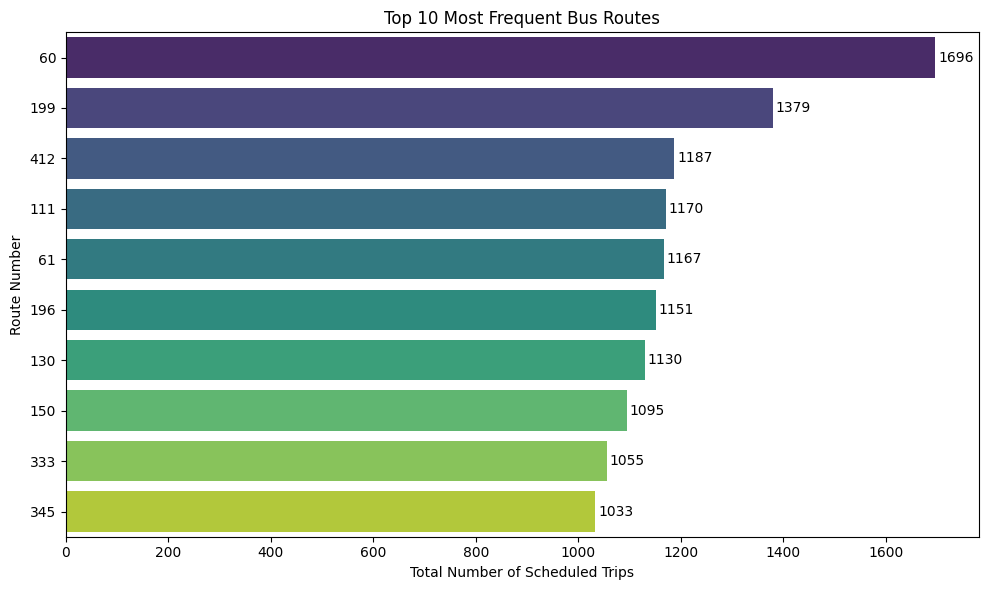

In [14]:
top_routes = pd.read_sql_query(
""" 
SELECT
    r.route_short_name,
    r.route_long_name,
    COUNT(t.trip_id) AS trip_count
FROM
    trips AS t
JOIN
    routes AS r ON t.route_id = r.route_id
GROUP BY
    r.route_short_name, r.route_long_name
ORDER BY
    trip_count DESC
LIMIT 10;
""",
engine
)
# Visualization
plt.figure(figsize=(10, 6))
ax = sns.barplot(
    x='trip_count',
    y='route_short_name',
    data=top_routes,
    palette='viridis',
    orient='h' 
)

plt.title('Top 10 Most Frequent Bus Routes')
plt.xlabel('Total Number of Scheduled Trips')
plt.ylabel('Route Number')
# Add labels to all bars
for container in ax.containers:
    ax.bar_label(container, padding=2)
plt.tight_layout()
plt.show()

How does service frequency vary by Day of the Week?

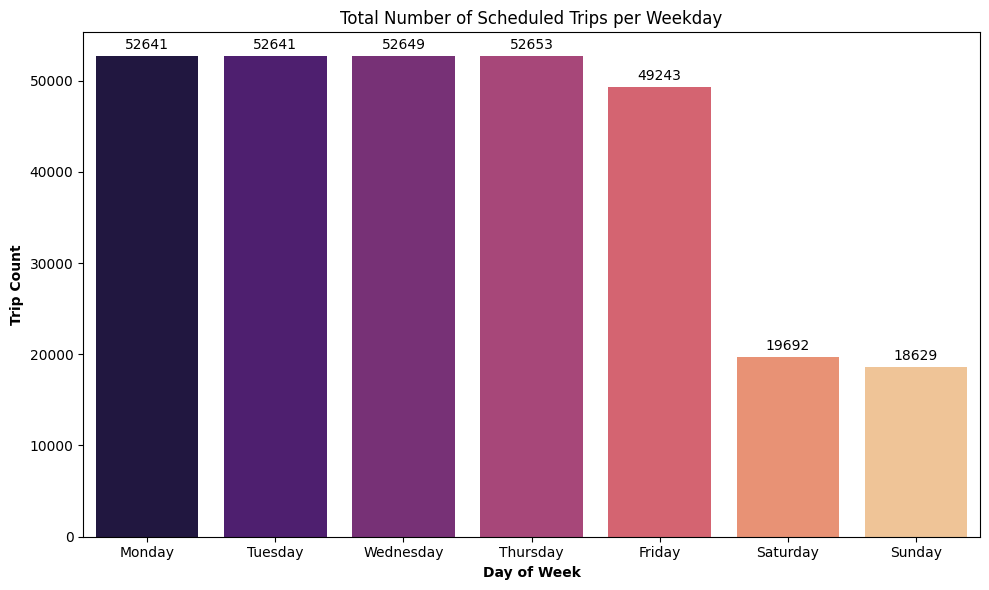

In [15]:
weekday_counts = pd.read_sql_query(
""" 
SELECT 
    SUM(CASE WHEN c.monday = 1 THEN 1 ELSE 0 END) AS monday_trips,
    SUM(CASE WHEN c.tuesday = 1 THEN 1 ELSE 0 END) AS tuesday_trips,
    SUM(CASE WHEN c.wednesday = 1 THEN 1 ELSE 0 END) AS wednesday_trips,
    SUM(CASE WHEN c.thursday = 1 THEN 1 ELSE 0 END) AS thursday_trips,
    SUM(CASE WHEN c.friday = 1 THEN 1 ELSE 0 END) AS friday_trips,
    SUM(CASE WHEN c.saturday = 1 THEN 1 ELSE 0 END) AS saturday_trips,
    SUM(CASE WHEN c.sunday = 1 THEN 1 ELSE 0 END) AS sunday_trips
FROM
    trips AS t
JOIN 
    calendar AS c ON t.service_id = c.service_id;
""",
engine
)
service_level = weekday_counts.T.reset_index()
service_level.columns = ['day', 'trip_count']
service_level['day']= service_level['day'].str.replace('_trips', '', regex=False).str.title()
plt.figure(figsize=(10,6))
ax = sns.barplot(
    x = 'day',
    y = 'trip_count',
    data = service_level,
    palette= 'magma'
)
plt.title('Total Number of Scheduled Trips per Weekday')
plt.xlabel('Day of Week', weight='bold')
plt.ylabel('Trip Count', weight='bold')
for container in ax.containers:
    ax.bar_label(container, padding=3)
plt.tight_layout()
plt.show()

What are the 10 busiest bus stops?

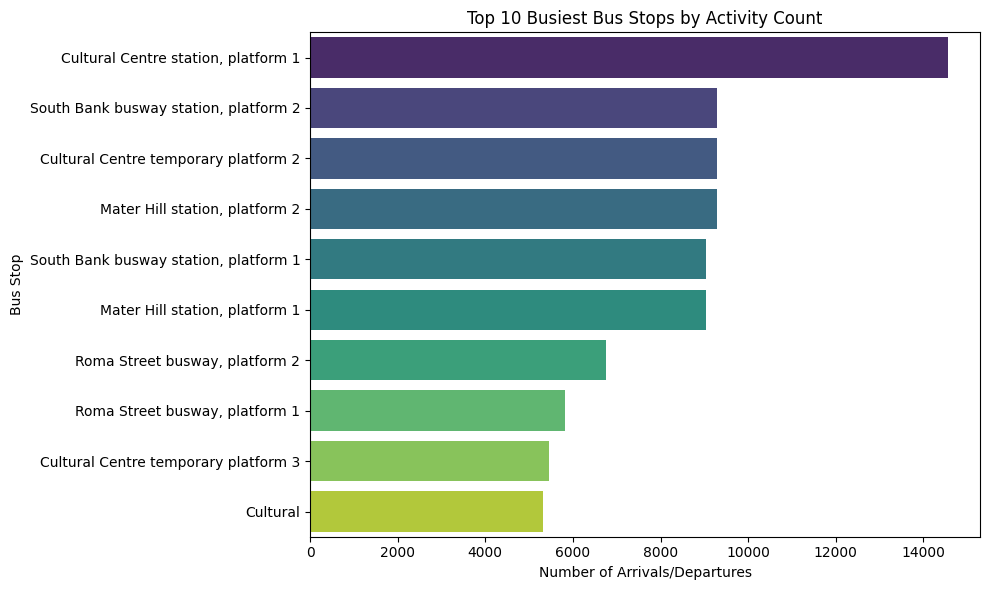

In [16]:
top_bus_stops =  pd.read_sql_query("""
WITH StopActivity AS (
    SELECT
        stop_id,
        COUNT(trip_id) AS activity_count
    FROM
        stop_times
    GROUP BY
        stop_id
)
SELECT
    s.stop_name,
    s.stop_id,
    sa.activity_count
FROM
    StopActivity AS sa
JOIN
    stops AS s ON s.stop_id = sa.stop_id::text
ORDER BY
    sa.activity_count DESC
LIMIT 10;
""",
engine
)
plt.figure(figsize=(10, 6))
sns.barplot(
    data=top_bus_stops,
    x='activity_count',
    y='stop_name',
    palette='viridis'
)
plt.title('Top 10 Busiest Bus Stops by Activity Count')
plt.xlabel('Number of Arrivals/Departures')
plt.ylabel('Bus Stop')
plt.tight_layout()
plt.show()
top_bus_stops['mode'] = 'Bus'

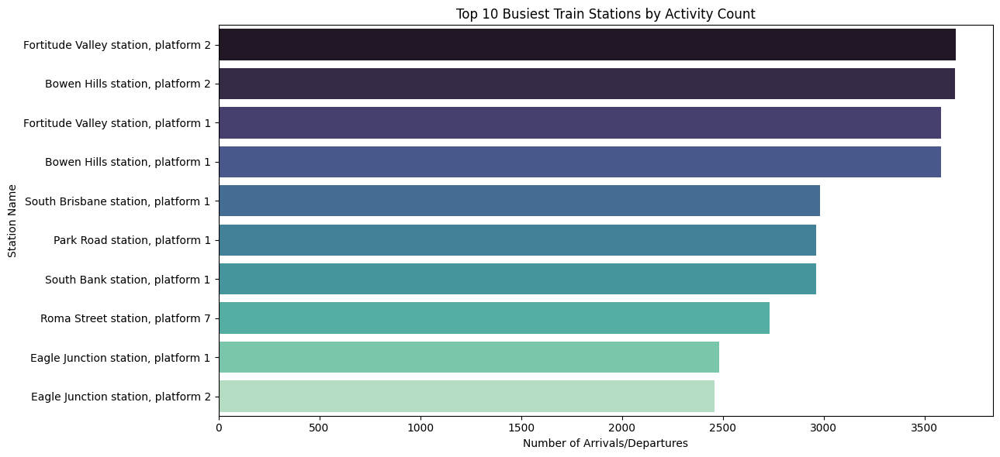

In [ ]:
#Top 10 Busiest Train Stations by Activity Count
top_train_stops = pd.read_sql_query(
""" 
WITH TrainRoutes AS (
    SELECT route_id
    FROM routes
    WHERE route_type = 2
),
TrainTrips AS (
    SELECT trip_id
    FROM trips
    WHERE route_id IN (SELECT route_id FROM TrainRoutes)
),
TrainStopActivity AS (
    SELECT
        stop_id,
        COUNT(*) AS activity_count
    FROM stop_times
    WHERE trip_id IN (SELECT trip_id FROM TrainTrips)
    GROUP BY stop_id
)
SELECT
    s.stop_name,
    tsa.activity_count
FROM
    TrainStopActivity AS tsa
JOIN
    stops AS s ON tsa.stop_id::text = s.stop_id
ORDER BY
    tsa.activity_count DESC
LIMIT 10;
""",
engine
)
top_train_stops['mode'] ='Train'

plt.figure(figsize=(13, 6))
sns.barplot(
    data=top_train_stops,
    x='activity_count',
    y='stop_name',
    palette='mako',
    orient='h'
)
plt.title('Top 10 Busiest Train Stations by Activity Count')
plt.xlabel('Number of Arrivals/Departures')
plt.ylabel('Station Name')
plt.tight_layout()
plt.show()



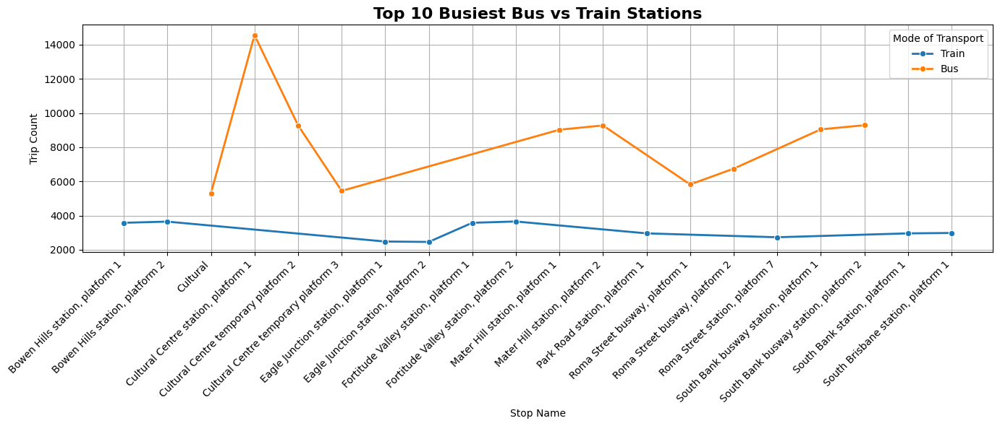

In [32]:
#Top 10 Busiest Bus vs Train Stations
combined_df = pd.concat([top_bus_stops, top_train_stops], ignore_index=True)
combined_df = combined_df.sort_values(by='stop_name')

plt.figure(figsize=(14, 6))
sns.lineplot(
    data=combined_df,
    x='stop_name',
    y='activity_count',
    hue='mode',
    marker='o',
    linewidth=2
)
plt.title("Top 10 Busiest Bus vs Train Stations", fontsize=16, weight='bold')
plt.xlabel("Stop Name")
plt.ylabel("Trip Count")
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.legend(title="Mode of Transport")
plt.tight_layout()
plt.show()


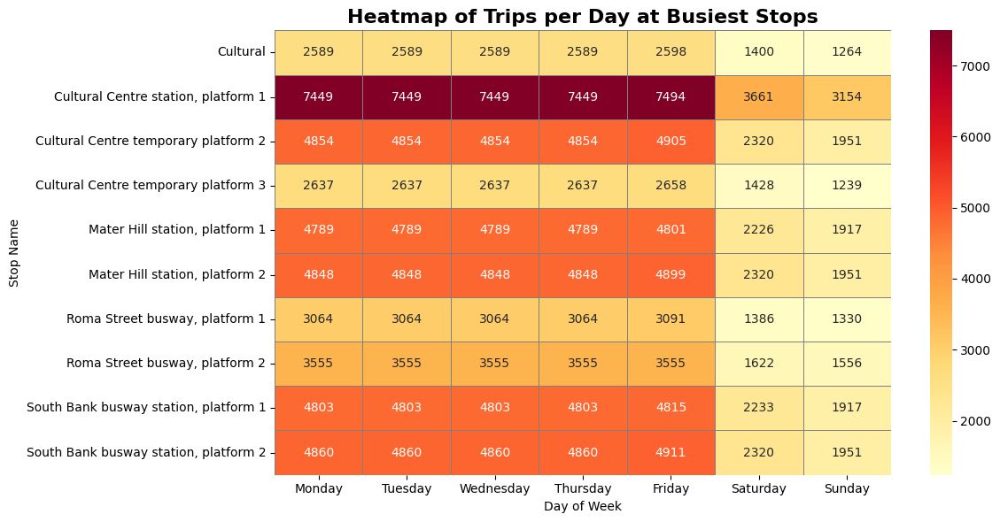

In [34]:
#Heatmap of Trips per Day at Busiest Stops
query = """
SELECT
    s.stop_name,
    day,
    COUNT(*) AS trip_count
FROM (
    SELECT
        st.stop_id,
        unnest(ARRAY[
            CASE WHEN c.monday = 1 THEN 'Monday' ELSE NULL END,
            CASE WHEN c.tuesday = 1 THEN 'Tuesday' ELSE NULL END,
            CASE WHEN c.wednesday = 1 THEN 'Wednesday' ELSE NULL END,
            CASE WHEN c.thursday = 1 THEN 'Thursday' ELSE NULL END,
            CASE WHEN c.friday = 1 THEN 'Friday' ELSE NULL END,
            CASE WHEN c.saturday = 1 THEN 'Saturday' ELSE NULL END,
            CASE WHEN c.sunday = 1 THEN 'Sunday' ELSE NULL END
        ]) AS day
    FROM stop_times st
    JOIN trips t ON st.trip_id = t.trip_id
    JOIN calendar c ON t.service_id = c.service_id
) AS days_expanded
JOIN stops s ON s.stop_id = days_expanded.stop_id::text
GROUP BY s.stop_name, day
ORDER BY s.stop_name, day;

"""

df = pd.read_sql_query(query, engine)

top_10_stops = df.groupby('stop_name')['trip_count'].sum().nlargest(10).index
df_top = df[df['stop_name'].isin(top_10_stops)]

pivot_df = df_top.pivot(index='stop_name', columns='day', values='trip_count').fillna(0)

ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
pivot_df = pivot_df[ordered_days]
plt.figure(figsize=(12, 6))
sns.heatmap(
    pivot_df,
    cmap="YlOrRd",      
    annot=True,       
    fmt=".0f",           
    linewidths=0.5,
    linecolor='gray'
)

plt.title("Heatmap of Trips per Day at Busiest Stops", fontsize=16, weight='bold')
plt.xlabel("Day of Week")
plt.ylabel("Stop Name")
plt.tight_layout()
plt.show()



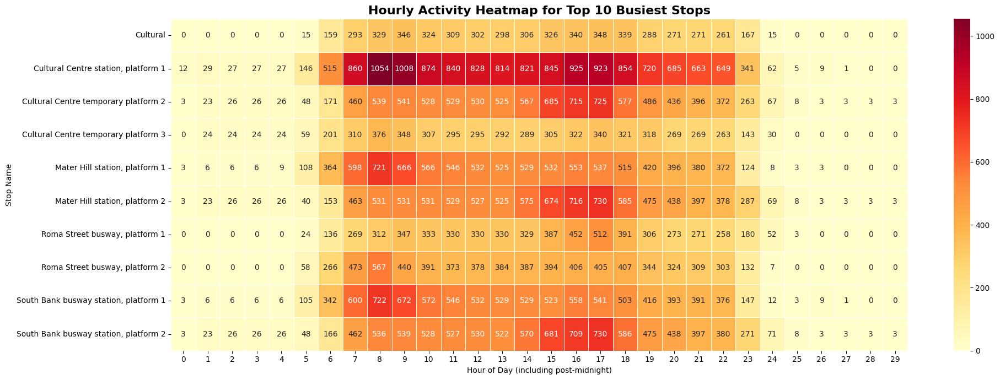

In [ ]:
#Hourly Activity Heatmap for Top 10 Busiest Stops
sql = """ 
SELECT 
    s.stop_name,
    CAST(split_part(st.arrival_time, ':', 1) AS INTEGER) AS hour,
    COUNT(*) AS trip_count
FROM stop_times st
JOIN stops s ON s.stop_id = st.stop_id::text
WHERE st.arrival_time IS NOT NULL 
  AND st.arrival_time ~ '^\d{1,2}:\d{2}:\d{2}$'
GROUP BY s.stop_name, hour
ORDER BY s.stop_name, hour
"""

df = pd.read_sql_query(sql, engine)  

top_stops = df.groupby('stop_name')['trip_count'].sum().nlargest(10).index
df_top = df[df['stop_name'].isin(top_stops)]

pivot_df = df_top.pivot(index='stop_name', columns='hour', values='trip_count').fillna(0)
pivot_df = pivot_df[sorted(pivot_df.columns)] 

plt.figure(figsize=(20, 7))
sns.heatmap(pivot_df, cmap='YlOrRd', annot=True, fmt='.0f', linewidths=0.5)
plt.title('Hourly Activity Heatmap for Top 10 Busiest Stops', fontsize=16, weight='bold')
plt.xlabel('Hour of Day (including post-midnight)')
plt.ylabel('Stop Name')
plt.tight_layout()
plt.show()


In [ ]:
all_stops = pd.read_sql_query("""
    SELECT stop_id, stop_name, stop_lat, stop_lon
    FROM stops;
""", engine)

map_center = [all_stops['stop_lat'].mean(), all_stops['stop_lon'].mean()]
m = folium.Map(location=map_center, zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

for idx, row in all_stops.iterrows():
    popup = folium.Popup(f"<b>{row['stop_name']}</b><br>Stop ID: {row['stop_id']}", max_width=300)
    folium.Marker(
        location=[row['stop_lat'], row['stop_lon']],
        popup=popup,
        tooltip=row['stop_name'],
        icon=folium.Icon(color='blue')
    ).add_to(marker_cluster) 
m